In [1]:
import pandas as pd
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
data = pd.read_csv("train.csv")
X, y, smiles = data.drop(["Tm","id","SMILES"], axis=1), data["Tm"], data["SMILES"]

idx_train, idx_val = train_test_split(
    X.index,
    test_size=0.2,
    random_state=42
)
X_train, y_train = X.iloc[idx_train], y.iloc[idx_train]

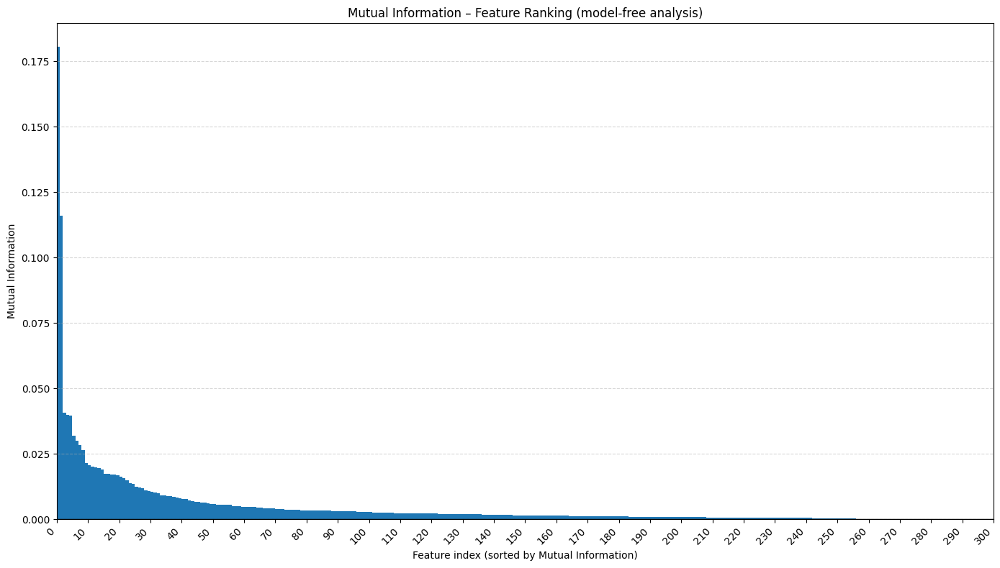

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.feature_selection import mutual_info_regression

# =========================
# Mutual Information
# =========================
mi = mutual_info_regression(
    X_train,
    y_train,
    n_neighbors=5,
    random_state=42
)

mi_series = (
    pd.Series(mi, index=X_train.columns)
      .sort_values(ascending=False)
)

# =========================
# Plot data
# =========================
feature_index = np.arange(len(mi_series))   # 0, 1, 2, ...
mi_values = mi_series.values

plt.figure(figsize=(14, 8))

# Bars – continuous, no gaps
plt.bar(
    feature_index,
    mi_values,
    width=1.0,
    align="edge"
)

# Zero baseline
plt.axhline(0, color="black", linewidth=1)

# Labels
plt.xlabel("Feature index (sorted by Mutual Information)")
plt.ylabel("Mutual Information")
plt.title("Mutual Information – Feature Ranking (model-free analysis)")

# X ticks: 0, 10, 20, ...
tick_positions = np.arange(0, len(feature_index), 10)

plt.xticks(
    ticks=tick_positions,
    labels=tick_positions,
    rotation=45,
    ha="right"
)

# Grid only on Y axis
plt.grid(axis="y", linestyle="--", alpha=0.5)
plt.xlim(0,300)
plt.tight_layout()
plt.show()


In [3]:
class SmilesNumericDataset(Dataset):
    def __init__(self, smiles, X_num, y):
        self.smiles = smiles.reset_index(drop=True)
        self.X_num = X_num.reset_index(drop=True)
        self.y = y.reset_index(drop=True)

    def __len__(self):
        return len(self.y)

    def __getitem__(self, idx):
        return {
            "smiles": self.smiles.iloc[idx],
            "numeric": torch.tensor(
                self.X_num.iloc[idx].values,
                dtype=torch.float32
            ),
            "y": torch.tensor(self.y.iloc[idx], dtype=torch.float32)
        }


In [4]:
from transformers import AutoTokenizer

MODEL_NAME = "seyonec/ChemBERTa-zinc-base-v1"
tokenizer = AutoTokenizer.from_pretrained(MODEL_NAME)

def collate_fn(batch):
    smiles = [b["smiles"] for b in batch]

    tok = tokenizer(
        smiles,
        padding=True,
        truncation=True,
        return_tensors="pt"
    )

    return {
        "input_ids": tok["input_ids"],
        "attention_mask": tok["attention_mask"],
        "numeric": torch.stack([b["numeric"] for b in batch]),
        "y": torch.stack([b["y"] for b in batch])
    }



Model that combine pretrained transformer suited for smiles chemical data with numerical columns.

In [ ]:
import torch
import torch.nn as nn
from transformers import AutoModel

class SmilesNumericRegressor(nn.Module):
    def __init__(self, n_num_features, dropout=0.3):
        super().__init__()

        # ======================
        # SMILES encoder
        # ======================
        self.smiles_encoder = AutoModel.from_pretrained(MODEL_NAME)
        smiles_dim = self.smiles_encoder.config.hidden_size

        for p in self.smiles_encoder.parameters():
            p.requires_grad = False
        self.smiles_encoder.eval()

        # ======================
        # Numeric branch
        # ======================
        self.num_encoder = nn.Sequential(
            nn.Linear(n_num_features, 64),
            nn.LayerNorm(64),
            nn.ReLU(),
            nn.Dropout(dropout)
        )

        # ======================
        # Fusion + regression
        # ======================
        self.smiles_norm = nn.LayerNorm(smiles_dim)

        self.head = nn.Sequential(
            nn.Linear(smiles_dim + 64, 128),
            nn.LeakyReLU(0.1),
            nn.Dropout(dropout * 0.7),
            nn.Linear(128, 1)
        )

    def forward(self, input_ids, attention_mask, num_features):
        # ---------- SMILES ----------
        with torch.no_grad():
            smiles_out = self.smiles_encoder(
                input_ids=input_ids,
                attention_mask=attention_mask
            )

        hidden = smiles_out.last_hidden_state
        mask = attention_mask.unsqueeze(-1).float()

        # SAFE mean pooling
        denom = mask.sum(dim=1).clamp(min=1.0)
        smiles_emb = (hidden * mask).sum(dim=1) / denom
        smiles_emb = self.smiles_norm(smiles_emb)

        # ---------- NUMERIC ----------
        num_features = num_features.float()
        num_emb = self.num_encoder(num_features)

        # ---------- FUSION ----------
        x = torch.cat([smiles_emb, num_emb], dim=1)
        return self.head(x).squeeze(1)


In [6]:
class EarlyStopping:
    def __init__(self, patience=12):
        self.patience = patience
        self.best_loss = float("inf")
        self.counter = 0
        self.best_state = None

    def step(self, val_metric, model):
        if val_metric < self.best_loss:
            self.best_loss = val_metric
            self.counter = 0
            self.best_state = {
                k: v.cpu().clone()
                for k, v in model.state_dict().items()
            }
            return False
        else:
            self.counter += 1
            return self.counter >= self.patience


In [ ]:
def train_one_k(k):
    print(f"\n===== TRAINING top_k = {k} =====")

    top_features = mi_series.index[:k]
    X_k = X[top_features]

    train_ds = SmilesNumericDataset(
        smiles.iloc[idx_train],
        X_k.iloc[idx_train],
        y.iloc[idx_train]
    )

    val_ds = SmilesNumericDataset(
        smiles.iloc[idx_val],
        X_k.iloc[idx_val],
        y.iloc[idx_val]
    )

    train_loader = DataLoader(
        train_ds,
        batch_size=32,
        shuffle=True,
        collate_fn=collate_fn
    )

    val_loader = DataLoader(
        val_ds,
        batch_size=64,
        shuffle=False,
        collate_fn=collate_fn
    )

    model = SmilesNumericRegressor(
        n_num_features=k,
        dropout=0.3
    ).to(DEVICE)

    # freeze SMILES encoder
    for p in model.smiles_encoder.parameters():
        p.requires_grad = False

    optimizer = torch.optim.AdamW(
        filter(lambda p: p.requires_grad, model.parameters()),
        lr=1e-3,
        weight_decay=1e-4
    )

    loss_fn = torch.nn.SmoothL1Loss(beta=1.0)

  
    early_stopping = EarlyStopping(patience=12)

    for epoch in range(1, 101):
        # ======================
        # TRAIN
        # ======================
        model.train()
        train_loss = 0.0

        for batch in train_loader:
            optimizer.zero_grad()

            preds = model(
                batch["input_ids"].to(DEVICE),
                batch["attention_mask"].to(DEVICE),
                batch["numeric"].to(DEVICE)
            )

            loss = loss_fn(
                preds.squeeze(),
                batch["y"].to(DEVICE)
            )

            loss.backward()
            optimizer.step()

            train_loss += loss.item()

        train_loss /= len(train_loader)

        # ======================
        # VALIDATION (MAE!)
        # ======================
        model.eval()
        val_mae = 0.0

        with torch.no_grad():
            for batch in val_loader:
                preds = model(
                    batch["input_ids"].to(DEVICE),
                    batch["attention_mask"].to(DEVICE),
                    batch["numeric"].to(DEVICE)
                )

                mae = torch.mean(
                    torch.abs(
                        preds.squeeze() - batch["y"].to(DEVICE)
                    )
                )

                val_mae += mae.item()

        val_mae /= len(val_loader)

        print(
            f"[k={k:3d}] "
            f"Epoch {epoch:03d} | "
            f"train_loss={train_loss:.4f} | "
            f"val_MAE={val_mae:.4f}"
        )

        if early_stopping.step(val_mae, model):
            print(f"⏹ Early stopping at epoch {epoch}")
            break

    return {
        "k": k,
        "best_val_mae": early_stopping.best_loss,
        "epochs": epoch
    }


Testing various numbers of columns to find out the best number

In [9]:
results = []

for k in range(10, 151, 10):
    res = train_one_k(k)
    results.append(res)


===== TRAINING top_k = 10 =====
[k= 10] Epoch 001 | train_loss=174.5298 | val_MAE=72.2388
[k= 10] Epoch 002 | train_loss=60.7686 | val_MAE=55.4129
[k= 10] Epoch 003 | train_loss=52.5456 | val_MAE=52.9053
[k= 10] Epoch 004 | train_loss=50.9767 | val_MAE=51.7915
[k= 10] Epoch 005 | train_loss=49.6504 | val_MAE=51.2344
[k= 10] Epoch 006 | train_loss=48.9438 | val_MAE=50.9570
[k= 10] Epoch 007 | train_loss=47.4048 | val_MAE=49.6946
[k= 10] Epoch 008 | train_loss=47.6185 | val_MAE=49.4625
[k= 10] Epoch 009 | train_loss=46.4150 | val_MAE=49.0327
[k= 10] Epoch 010 | train_loss=46.4292 | val_MAE=48.2987
[k= 10] Epoch 011 | train_loss=46.4104 | val_MAE=48.1500
[k= 10] Epoch 012 | train_loss=45.6223 | val_MAE=47.6195
[k= 10] Epoch 013 | train_loss=45.3059 | val_MAE=47.4278
[k= 10] Epoch 014 | train_loss=44.8595 | val_MAE=47.1284
[k= 10] Epoch 015 | train_loss=43.5303 | val_MAE=46.9526
[k= 10] Epoch 016 | train_loss=44.4069 | val_MAE=46.5620
[k= 10] Epoch 017 | train_loss=44.3160 | val_MAE=46.47

In [10]:
results_df = (
    pd.DataFrame(results)
      .sort_values("best_val_mae")
)
results_df

,k,best_val_mae,epochs
12,130,35.432096,68
9,100,35.561122,79
13,140,35.611360,67
6,70,35.985755,86
14,150,36.128265,49
8,90,36.154459,64
10,110,36.161495,65
7,80,36.286143,69
5,60,36.404769,100
11,120,36.836964,43


LightGBM + feature extraction from smiles

In [1]:
import pandas as pd
data = pd.read_csv("train.csv")
X, y, smiles = data.drop(["Tm","id","SMILES"], axis=1), data["Tm"], data["SMILES"]

In [2]:
from rdkit.Chem import Lipinski, Crippen, rdMolDescriptors
from rdkit import Chem

def extract_features(smiles: str):
    """
    Extracting chemical features using Chem library
    """
    
    mol = Chem.MolFromSmiles(smiles)
    if mol is None:
        return None

    return {
        # Composition & mass
        "ExactMolWt": rdMolDescriptors.CalcExactMolWt(mol),

        # Physicochemical descriptors
        "LogP": Crippen.MolLogP(mol),
        "TPSA": rdMolDescriptors.CalcTPSA(mol),
        "Fraction_CSP3": rdMolDescriptors.CalcFractionCSP3(mol),
        "Formal_Charge": sum(atom.GetFormalCharge() for atom in mol.GetAtoms()),

        # Topology
        "Num_Rings": rdMolDescriptors.CalcNumRings(mol),
        "Num_Aromatic_Rings": rdMolDescriptors.CalcNumAromaticRings(mol),
        "Rotatable_Bonds": Lipinski.NumRotatableBonds(mol),

        # Atomic composition
        "Heavy_Atom_Count": rdMolDescriptors.CalcNumHeavyAtoms(mol),
        "Num_Heteroatoms": rdMolDescriptors.CalcNumHeteroatoms(mol),
        "Num_StereoCenters": rdMolDescriptors.CalcNumAtomStereoCenters(mol),

        # H-bonding / Drug-likeness features
        "HBA": Lipinski.NumHAcceptors(mol),
        "HBD": Lipinski.NumHDonors(mol),
    }

features_list = [extract_features(s) for s in smiles]
df_custom_features = pd.DataFrame([f for f in features_list if f is not None])
print(df_custom_features)

      ExactMolWt     LogP   TPSA  Fraction_CSP3  Formal_Charge  Num_Rings  \
0     161.990419  2.42120   0.00       0.500000              0          1   
1     217.089149  4.47430  15.79       0.000000              0          4   
2     160.100048  2.36462  17.82       0.300000              0          2   
3      84.021129  0.09430  37.30       0.250000              0          0   
4     118.081621  2.49490   0.00       1.000000              0          0   
...          ...      ...    ...            ...            ...        ...   
2657  141.918490  1.62010   0.00       1.000000              0          0   
2658  142.909632  1.88018  23.79       0.500000              0          0   
2659  156.093900  3.45664   0.00       0.166667              0          2   
2660  184.088815  3.43250  17.07       0.153846              0          2   
2661  198.999661  2.51510   3.24       0.250000              0          1   

      Num_Aromatic_Rings  Rotatable_Bonds  Heavy_Atom_Count  Num_Heteroatom

In [3]:
from collections import Counter
def element_counts(smiles: str):
    """
    Counting the number of chemical elements
    """
    mol = Chem.MolFromSmiles(smiles)
    if mol is None:
        return None
    # List of element symbols in the molecule
    elements = [atom.GetSymbol() for atom in mol.GetAtoms()]
    return dict(Counter(elements))

counts = []
for s in smiles:
    counts.append(element_counts(s))
    
df_chemical_elements = pd.DataFrame(counts).fillna(0)

In [4]:
df = pd.concat([X, df_custom_features], axis=1)
df = pd.concat([df, df_chemical_elements], axis=1)
df.columns = df.columns.str.replace(r"\s+", "_", regex=True)
df.shape

(2662, 447)

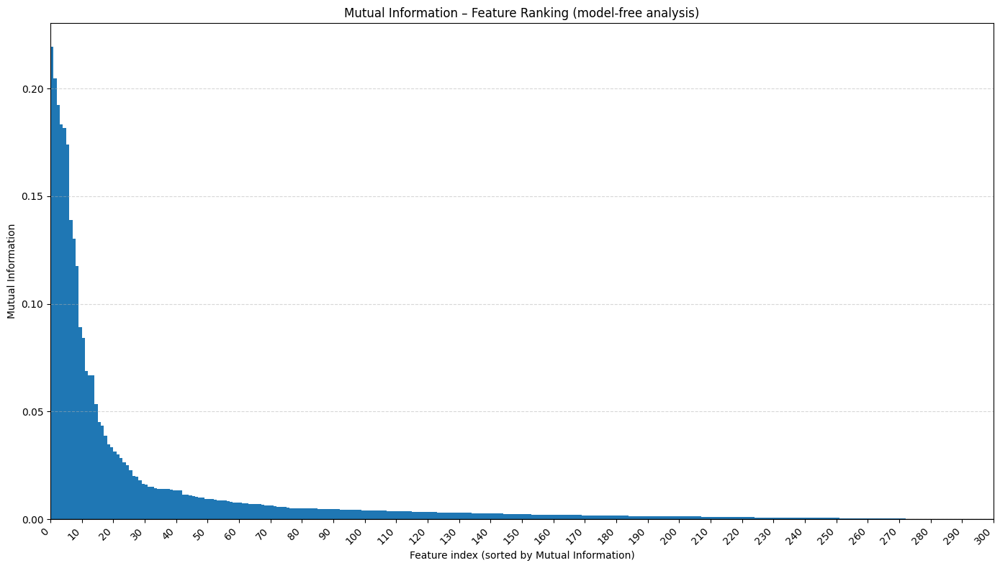

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.feature_selection import mutual_info_regression

# =========================
# Mutual Information
# =========================
mi = mutual_info_regression(
    df,
    y,
    n_neighbors=5,
    random_state=42
)

mi_series = (
    pd.Series(mi, index=df.columns)
      .sort_values(ascending=False)
)

# =========================
# Plot data
# =========================
feature_index = np.arange(len(mi_series))   # 0, 1, 2, ...
mi_values = mi_series.values

plt.figure(figsize=(14, 8))

# Bars – continuous, no gaps
plt.bar(
    feature_index,
    mi_values,
    width=1.0,
    align="edge"
)

# Zero baseline
plt.axhline(0, color="black", linewidth=1)

# Labels
plt.xlabel("Feature index (sorted by Mutual Information)")
plt.ylabel("Mutual Information")
plt.title("Mutual Information – Feature Ranking (model-free analysis)")

# X ticks: 0, 10, 20, ...
tick_positions = np.arange(0, len(feature_index), 10)

plt.xticks(
    ticks=tick_positions,
    labels=tick_positions,
    rotation=45,
    ha="right"
)

# Grid only on Y axis
plt.grid(axis="y", linestyle="--", alpha=0.5)
plt.xlim(0,300)
plt.tight_layout()
plt.show()


In [10]:
import numpy as np
import pandas as pd
import lightgbm as lgb
from sklearn.model_selection import train_test_split
X_train_full, X_val_full, y_train, y_val = train_test_split(
    df,
    y,
    test_size=0.2,
    random_state=42
)
step = 10
top_k_values = list(range(10, 250, step))  # np. do 200


In [68]:
import lightgbm as lgb
import numpy as np

results = []

for k in top_k_values:
    print(f"\n=== Testing top_k = {k} ===")

    top_features = mi_series.index[:k]

    X_train = X_train_full[top_features]
    X_val   = X_val_full[top_features]

    model = lgb.LGBMRegressor(
        objective="mae",
        n_estimators=2000,
        learning_rate=0.03,
        num_leaves=31,
        max_depth=-1,
        min_data_in_leaf=20,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42
    )

    model.fit(
        X_train,
        y_train,
        eval_set=[(X_val, y_val)],
        eval_metric="mae",
        callbacks=[
            lgb.early_stopping(50),
            lgb.log_evaluation(period=0)  # cisza w logach
        ]
    )

    val_mae = model.best_score_["valid_0"]["l1"]

    results.append({
        "top_k": k,
        "val_mae": val_mae
    })

    print(f">>> top_k = {k:3d} | Val MAE = {val_mae:.4f}")



=== Testing top_k = 10 ===
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0,002030 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 546
[LightGBM] [Info] Number of data points in the train set: 2129, number of used features: 10
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Info] Start training from score 278,149994
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[1473]	valid_0's l1: 35.2251
>>> top_k =  10 | Val MAE = 35.2251

=== Testing top_k = 20 ===
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will 

In [70]:
import pandas as pd

results_df = pd.DataFrame(results).sort_values("val_mae")
results_df


,top_k,val_mae
18,190,30.715360
9,100,30.734074
19,200,30.762269
23,240,30.781978
15,160,30.858038
21,220,30.972306
22,230,30.972306
17,180,31.087381
16,170,31.087381
10,110,31.108134


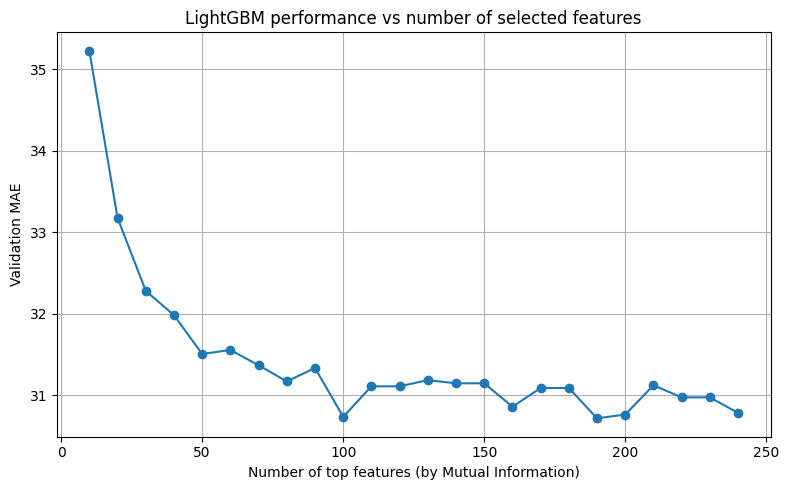

In [72]:
import matplotlib.pyplot as plt

plot_df = results_df.sort_values("top_k")

plt.figure(figsize=(8, 5))
plt.plot(
    plot_df["top_k"],
    plot_df["val_mae"],
    marker="o"
)

plt.xlabel("Number of top features (by Mutual Information)")
plt.ylabel("Validation MAE")
plt.title("LightGBM performance vs number of selected features")
plt.grid(True)
plt.tight_layout()
plt.show()


With selected top 100 variables from numerical + encoded smiles, we perform random search for best variables with 10-fold CV

In [11]:
from sklearn.model_selection import KFold
import numpy as np
import lightgbm as lgb
def lgb_kfold_cv(
    X, y,
    params,
    n_splits=10,
    random_state=42
):
    kf = KFold(
        n_splits=n_splits,
        shuffle=True,
        random_state=random_state
    )

    fold_mae = []
    best_iters = []

    for fold, (train_idx, val_idx) in enumerate(kf.split(X)):
        X_tr, X_va = X.iloc[train_idx], X.iloc[val_idx]
        y_tr, y_va = y.iloc[train_idx], y.iloc[val_idx]

        model = lgb.LGBMRegressor(
            objective="mae",
            n_estimators=5000,
            learning_rate=0.03,
            random_state=42,
            device="gpu",          
            gpu_platform_id=0,
            gpu_device_id=0,
            **params
        )

        model.fit(
            X_tr, y_tr,
            eval_set=[(X_va, y_va)],
            eval_metric="mae",
            callbacks=[
                lgb.early_stopping(80),
                lgb.log_evaluation(0)
            ]
        )

        fold_mae.append(model.best_score_["valid_0"]["l1"])
        best_iters.append(model.best_iteration_)

    return {
        "mae_mean": np.mean(fold_mae),
        "mae_std": np.std(fold_mae),
        "best_iter_mean": int(np.mean(best_iters))
    }


In [ ]:
param_space = {
    "max_depth": [4, 6, 8, 10],
    "num_leaves": [31, 63, 127],
    "min_data_in_leaf": [20, 40, 80],
    "subsample": [0.6, 0.8],
    "colsample_bytree": [0.6, 0.8],
    "lambda_l2": [0, 1.0, 10.0],
    "min_gain_to_split": [0.0, 0.1],   
    "max_bin": [255]              
}

import itertools
import pandas as pd
import numpy as np

results = []
top_features = mi_series.index[:100]
X = df[top_features]
all_params = list(itertools.product(*param_space.values()))
np.random.shuffle(all_params)

for params_tuple in all_params[:25]:  # <<< 25 wystarczy
    params = dict(zip(param_space.keys(), params_tuple))

    cv_res = lgb_kfold_cv(
        df, y,
        params=params,
        n_splits=10
    )

    results.append({
        **params,
        **cv_res
    })


[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] lambda_l2 is set=10.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10.0
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] lambda_l2 is set=10.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10.0
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 1112
[LightGBM] [Info] Number of data points in the train set: 2395, number of used features: 73
[LightGBM] [Info] Using requested OpenCL platform 0 device 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 4070 SUPER

,max_depth,num_leaves,min_data_in_leaf,subsample,colsample_bytree,lambda_l2,min_gain_to_split,max_bin,mae_mean,mae_std,best_iter_mean
22,10,31,20,0.6,0.6,10.0,0.0,255,30.552612,1.859576,1058
21,8,127,20,0.6,0.6,1.0,0.0,255,30.856852,2.029334,1178
17,10,31,40,0.8,0.8,10.0,0.0,255,31.325697,1.400214,1366
6,4,31,20,0.8,0.6,1.0,0.0,255,31.340224,2.261633,1803
23,6,31,40,0.6,0.6,0.0,0.0,255,31.348815,1.580297,1982


In [16]:
df = pd.DataFrame(results).sort_values("mae_mean")
df.head()

,max_depth,num_leaves,min_data_in_leaf,subsample,colsample_bytree,lambda_l2,min_gain_to_split,max_bin,mae_mean,mae_std,best_iter_mean
22,10,31,20,0.6,0.6,10.0,0.0,255,30.552612,1.859576,1058
21,8,127,20,0.6,0.6,1.0,0.0,255,30.856852,2.029334,1178
17,10,31,40,0.8,0.8,10.0,0.0,255,31.325697,1.400214,1366
6,4,31,20,0.8,0.6,1.0,0.0,255,31.340224,2.261633,1803
23,6,31,40,0.6,0.6,0.0,0.0,255,31.348815,1.580297,1982


In [17]:
df = pd.DataFrame(results).sort_values("mae_std")
df.head()

,max_depth,num_leaves,min_data_in_leaf,subsample,colsample_bytree,lambda_l2,min_gain_to_split,max_bin,mae_mean,mae_std,best_iter_mean
2,8,31,40,0.6,0.6,0.0,0.1,255,31.472626,1.372814,1190
17,10,31,40,0.8,0.8,10.0,0.0,255,31.325697,1.400214,1366
18,6,31,40,0.6,0.6,10.0,0.0,255,31.359962,1.414585,1558
5,8,63,40,0.6,0.6,0.0,0.1,255,31.421341,1.502996,1307
24,8,63,80,0.8,0.8,10.0,0.0,255,32.573704,1.506296,1378


In [19]:
df["mae_upper"] = df["mae_mean"] + df["mae_std"]

best_row = df.sort_values("mae_upper").iloc[0]
best_row

max_depth              10.000000
num_leaves             31.000000
min_data_in_leaf       20.000000
subsample               0.600000
colsample_bytree        0.600000
lambda_l2              10.000000
min_gain_to_split       0.000000
max_bin               255.000000
mae_mean               30.552612
mae_std                 1.859576
best_iter_mean       1058.000000
mae_upper              32.412188
Name: 22, dtype: float64

In the final notebook we gonna perform narrowed gridsearch and then train full model with the best params